In [24]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
import os
import pandas as pd
import sns

Datasets https://www.kaggle.com/datasets/tongpython/cat-and-dog

In [25]:
path_test = "cat&dog/test_set"
path_train = "cat&dog/training_set"

In [26]:
def plot_image(path,int_type):
    _path = path
    label = None
    
    if int_type ==0:
        _path = _path + "/" + "cats"
        label = 0
    else:
        _path = _path + "/" + "dogs"
        label = 1
        
    plt.figure(figsize = (30,30))
    plt.subplots_adjust(top=None, bottom=None, left=None, right=None, wspace=0.2, hspace=0.5)
    
    lst_img_name = os.listdir(_path)#görsel isimlerini tutuyor(.png uzantılı)
    
    for i in range(1,17,1):#1 den 17 ye kadar 
        th = np.random.randint(1,(len(lst_img_name)-1))
        plt.subplot(4,4,i)
        img = _path + "/" +lst_img_name[th] 
        
        img = cv.imread(img)
        plt.imshow(img)
        
        if label == 0:
            plt.title("cat")
        else :
            plt.title("dog")

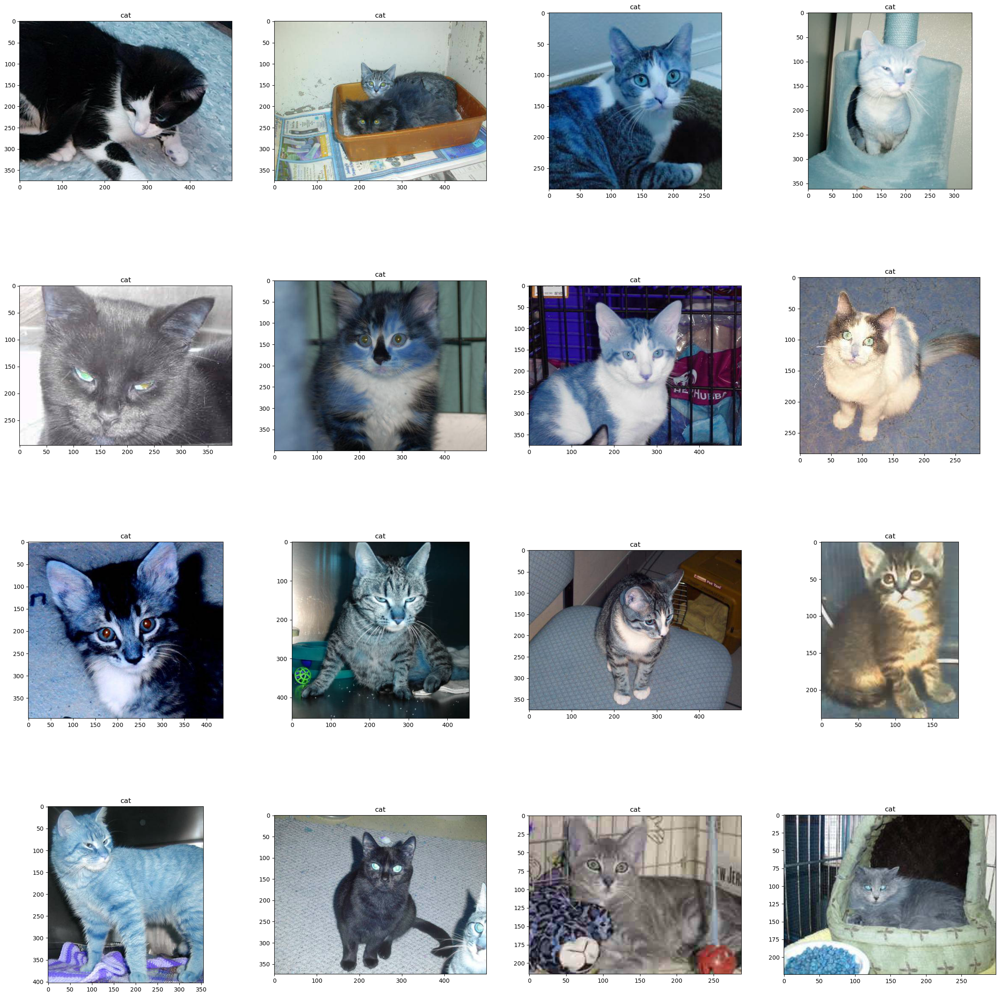

In [27]:
plot_image(path_train,0) # kedi görselleri

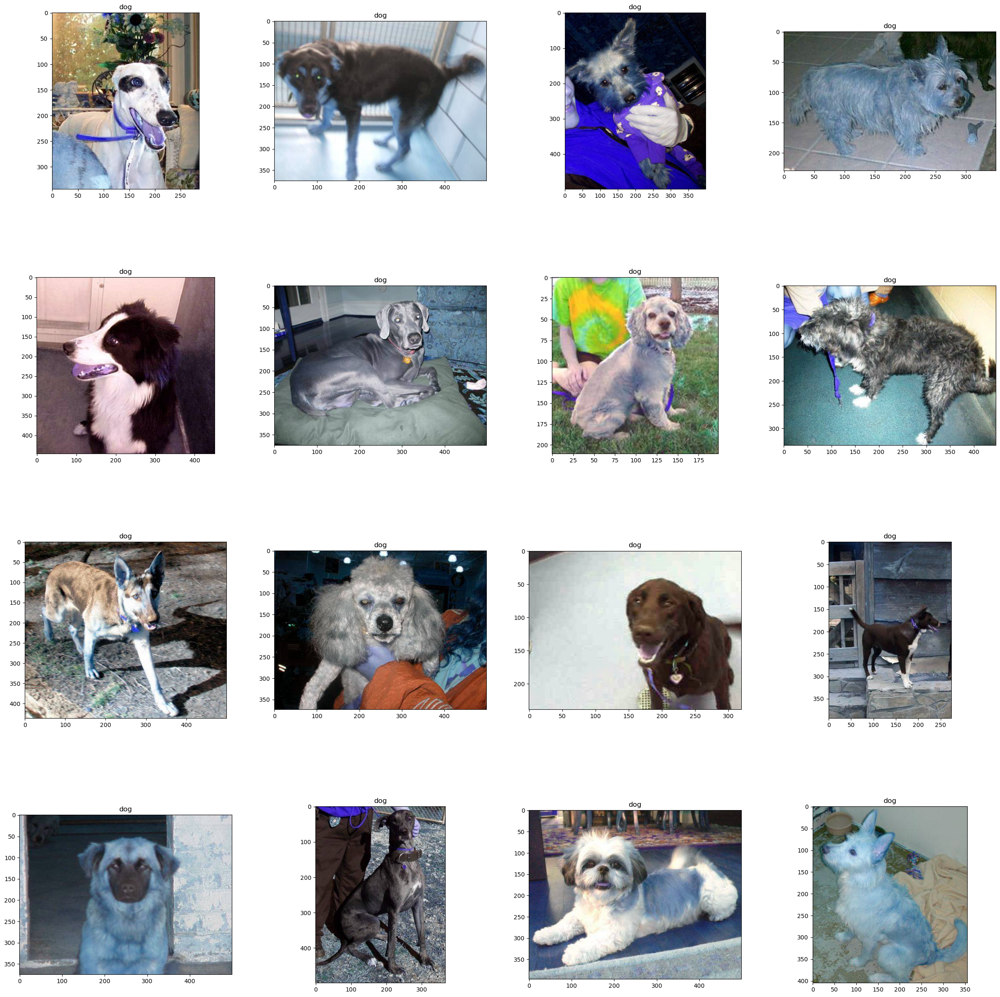

In [28]:
plot_image(path_train,1)

In [29]:
import tensorflow as tf
import keras.utils as image
from keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator,load_img

#preprocessing
train_data = ImageDataGenerator(rotation_range=15,
    rescale=1./255,
    shear_range=0.1,
    zoom_range=0.2,
    horizontal_flip=True,
    width_shift_range=0.1,
    height_shift_range=0.1)
test_data = ImageDataGenerator(rescale=1./255)

train_data = train_data.flow_from_directory(
            directory = path_train,
            batch_size = 5,
            target_size =(128,128),
            class_mode ="categorical",)
test_data = test_data.flow_from_directory(
            directory = path_test,
            batch_size = 32,
            target_size =(128,128),
            class_mode ="categorical")


Found 8005 images belonging to 2 classes.
Found 2023 images belonging to 2 classes.


In [55]:
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Dense, Dropout, Flatten,BatchNormalization
from tensorflow.keras.optimizers import Adam
from keras.preprocessing.image import ImageDataGenerator

model = Sequential()

model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(128, 128, 3)))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Flatten())
model.add(Dense(512, activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.5))
model.add(Dense(2, activation='softmax')) # 2 because we have cat and dog classes

model.compile(loss='categorical_crossentropy', optimizer='rmsprop', metrics=['accuracy'])

model.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_15 (Conv2D)          (None, 126, 126, 32)      896       
                                                                 
 batch_normalization_14 (Bat  (None, 126, 126, 32)     128       
 chNormalization)                                                
                                                                 
 max_pooling2d_14 (MaxPoolin  (None, 63, 63, 32)       0         
 g2D)                                                            
                                                                 
 dropout_12 (Dropout)        (None, 63, 63, 32)        0         
                                                                 
 conv2d_16 (Conv2D)          (None, 61, 61, 64)        18496     
                                                                 
 batch_normalization_15 (Bat  (None, 61, 61, 64)      

In [56]:

history = model.fit(train_data, epochs=10, validation_data=test_data)

Epoch 1/10
1601/1601 [==============================] - 245s 152ms/step - loss: 0.8988 - accuracy: 0.5551 - val_loss: 1.3435 - val_accuracy: 0.5195
Epoch 2/10
1601/1601 [==============================] - 171s 107ms/step - loss: 0.7089 - accuracy: 0.6064 - val_loss: 0.8569 - val_accuracy: 0.5581
Epoch 3/10
1601/1601 [==============================] - 182s 114ms/step - loss: 0.6907 - accuracy: 0.6213 - val_loss: 0.7213 - val_accuracy: 0.6426
Epoch 4/10
1601/1601 [==============================] - 181s 113ms/step - loss: 0.6725 - accuracy: 0.6359 - val_loss: 0.7104 - val_accuracy: 0.6500
Epoch 5/10
1601/1601 [==============================] - 188s 117ms/step - loss: 0.6608 - accuracy: 0.6514 - val_loss: 0.5804 - val_accuracy: 0.7079
Epoch 6/10
1601/1601 [==============================] - 180s 113ms/step - loss: 0.6492 - accuracy: 0.6543 - val_loss: 0.7746 - val_accuracy: 0.5932
Epoch 7/10
1601/1601 [==============================] - 183s 114ms/step - loss: 0.6392 - accuracy: 0.6674 - val_

In [30]:
#28s 112ms/step - loss: 0.5480 - accuracy: 0.7224 - val_loss: 0.5555 - val_accuracy: 0.7182
model.save("cat_dog_model2.h5")

In [33]:
from keras.utils import load_img,img_to_array
from keras.models import load_model
model = load_model("cat_dog_model2.h5")
def test_model(path, model, int_type):
    pred=[]
    _path = path
    label = None
    predict_label = None
    if int_type == 0:
        _path = _path + "/" + "cats"
        label = 0
    else:
        _path = _path + "/" + "dogs"
        label = 1
    
    plt.figure(figsize=(30, 30))
    plt.subplots_adjust(top=None, bottom=None, left=None, right=None, wspace=0.2, hspace=0.5)
    lst_img_name = os.listdir(_path)
    for i in range(1,17):
        th = np.random.randint(0, len(lst_img_name) - 1)
        plt.subplot(4, 4, i)
        img = _path + "/" + lst_img_name[th]
        image_test = load_img(img, target_size=(128,128, 3))
        image_test = img_to_array(image_test)
        image_test = np.expand_dims(image_test, axis = 0)
        predict = model.predict(image_test)
        #pred.append(predict)
        cat_dog = np.argmax(predict)
        if cat_dog ==0:
            tur = "Cat"
        else:
            tur = "Dog"
        img = cv.imread(img)
        plt.imshow(img)
        plt.title(tur)
        

1/1 [==============================] - 0s 24ms/step


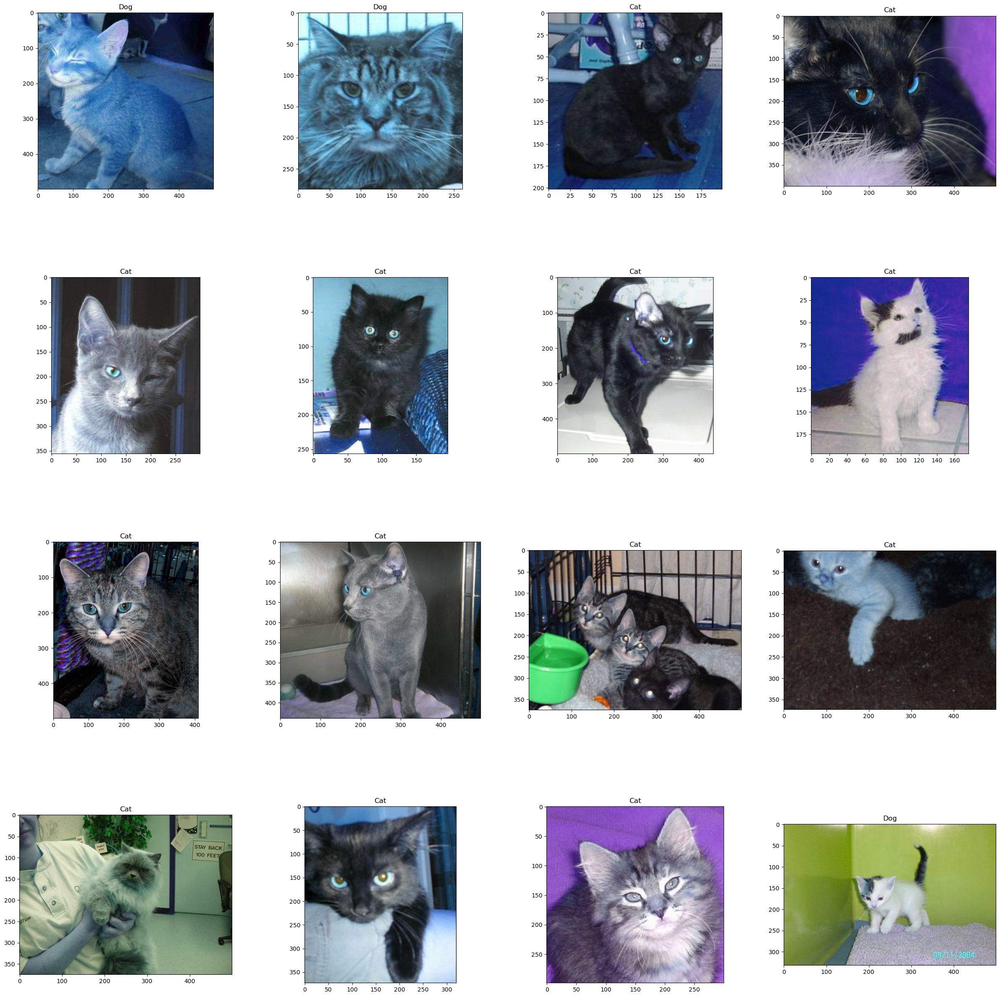

In [34]:
test_model(path_test,model,0)

1/1 [==============================] - 0s 23ms/step


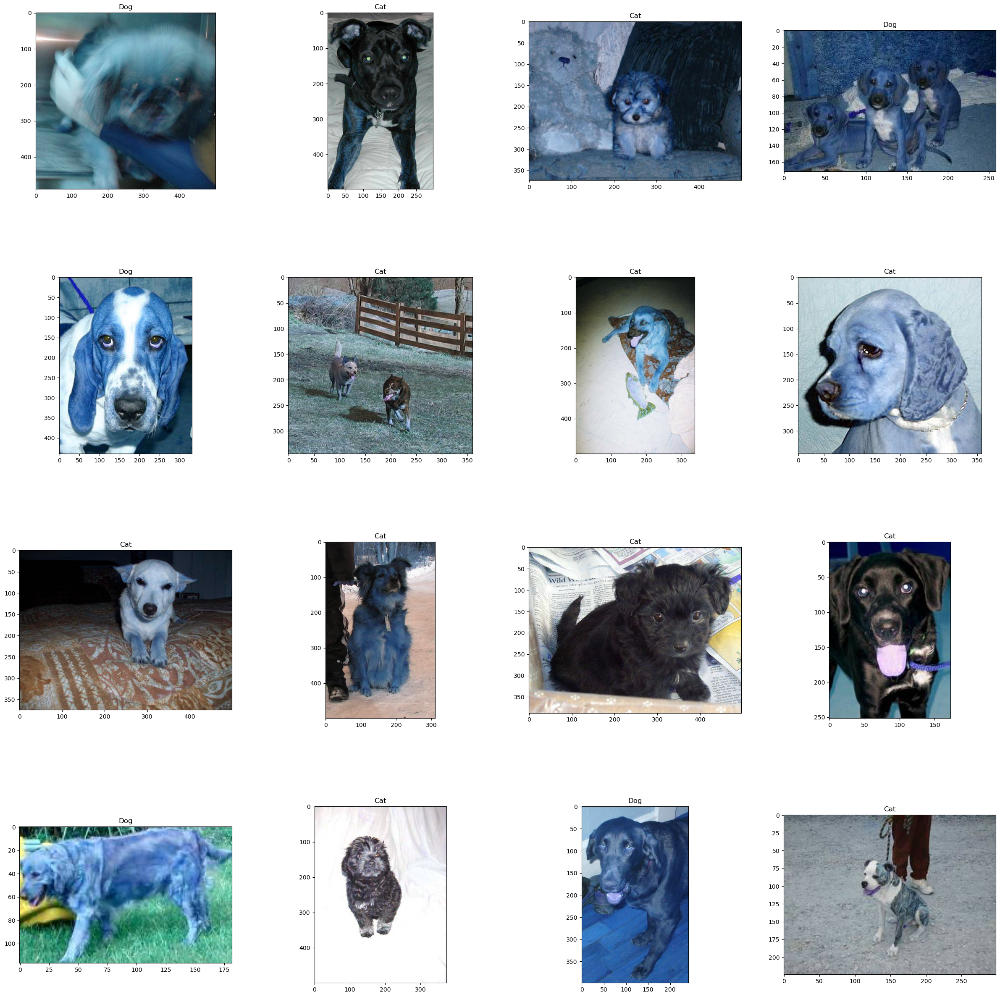

In [35]:
test_model(path_test,model,1)

In [48]:
import tensorflow as tf
from tensorflow.keras.utils import load_img,img_to_array,array_to_img
test_image = load_img("cat.jpg",target_size=(128,128))


1/1 [==============================] - 0s 19ms/step


'Cat'

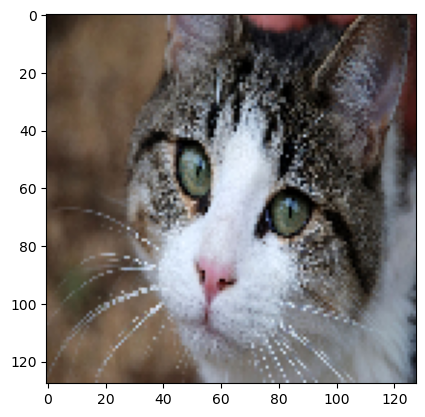

In [49]:
import matplotlib.pyplot as plt

plt.imshow(test_image)
test_image = img_to_array(test_image)
test_image = np.expand_dims(test_image,axis = 0)
result = model.predict(test_image)
pre = np.argmax(result)
if pre ==0:
    tur = "Cat"
else:
    tur = "Dog"
tur


In [107]:
import cv2 as cv

cap = cv.VideoCapture(0)
w,h=128*4,128*4
cap.set(3,w)
cap.set(4,h)
while True:
    if cap.isOpened():
        ret,frame = cap.read()
        
        if not ret:
            print("veri alınamadı")
            break
        else:
            frame = cv.resize(frame,(128,128))
            frame = cv.cvtColor(frame,cv.COLOR_BGR2RGB)
            frame = frame.reshape(128,128,3)
            img = img_to_array(frame)
            img = np.expand_dims(img, axis = 0)
            pre = model.predict(img)
            cat_dog = np.argmax(pre)
            
            
            if cat_dog ==0:
                type_animal = "cat"
            else:
                type_animal = "dog"
            pre = str(pre)
            frame = cv.resize(frame,(w,h))
            cv.putText(frame,type_animal+pre[0:3],(0,20),cv.FONT_HERSHEY_COMPLEX_SMALL,1,(0,0,255),1)
            cv.imshow("cam",frame)
    if cv.waitKey(27) & 0xFF == ord("q"):
        break
cap.release()
cv.destroyAllWindows()

1/1 [==============================] - 0s 25ms/step


In [70]:
cap.release()
cv.destroyAllWindows()